
Processing 'zombie'...
  Found live file: 'song_zombie.mp3'
  Normalizing audio signals...
  Performing time alignment using cross-correlation...
  Comparing alignment accuracy...
    Cross-Correlation alignment error: 1079.66
  Computing STFT using Cross-Correlation aligned audio...
  Applying spectral subtraction with adjusted scaling factor...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_zombie.wav'.
  Plotting the results...


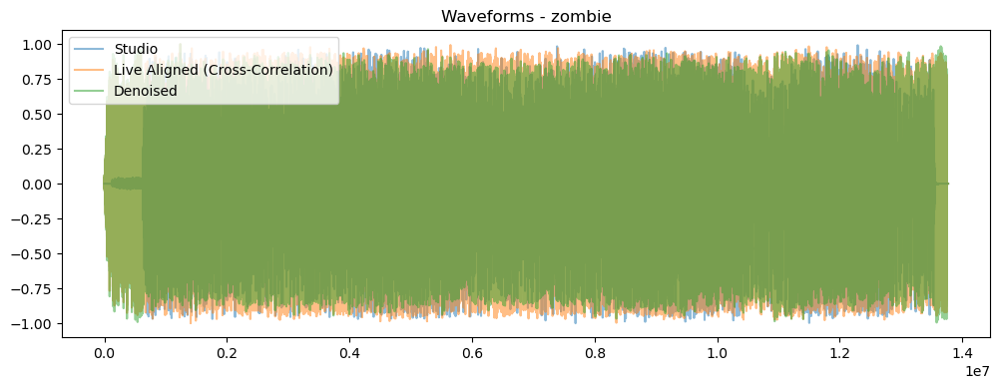

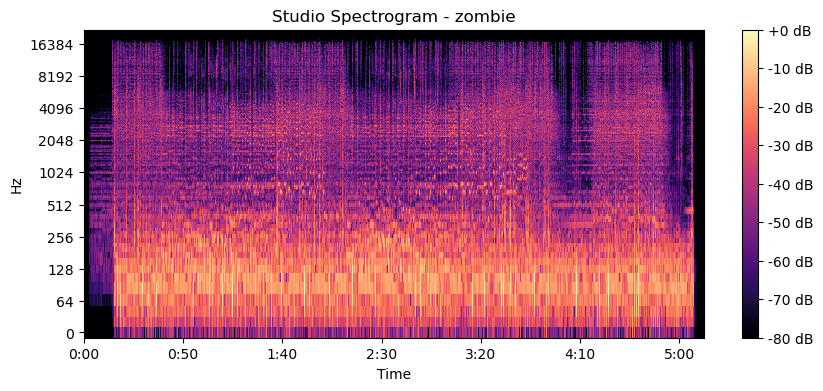

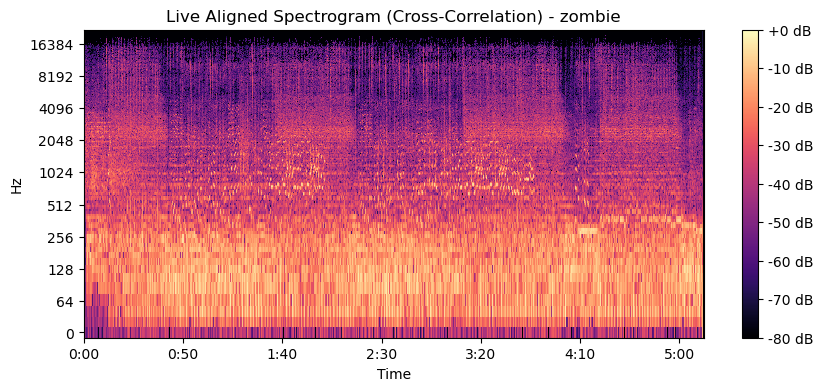

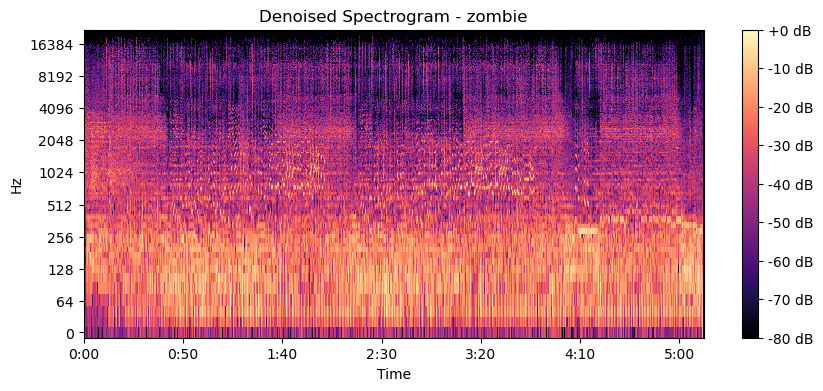

Finished processing 'zombie'.


Processing 'creep'...
  Found live file: 'song_creep.m4a'
  Normalizing audio signals...
  Performing time alignment using cross-correlation...
  Comparing alignment accuracy...
    Cross-Correlation alignment error: 835.22
  Computing STFT using Cross-Correlation aligned audio...
  Applying spectral subtraction with adjusted scaling factor...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_creep.wav'.
  Plotting the results...


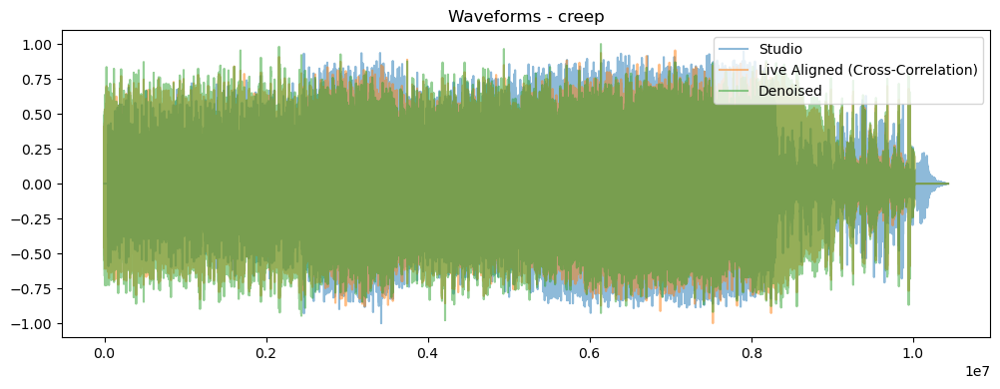

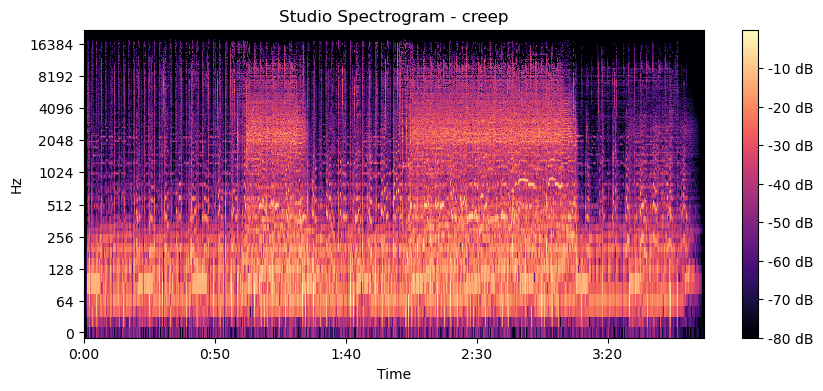

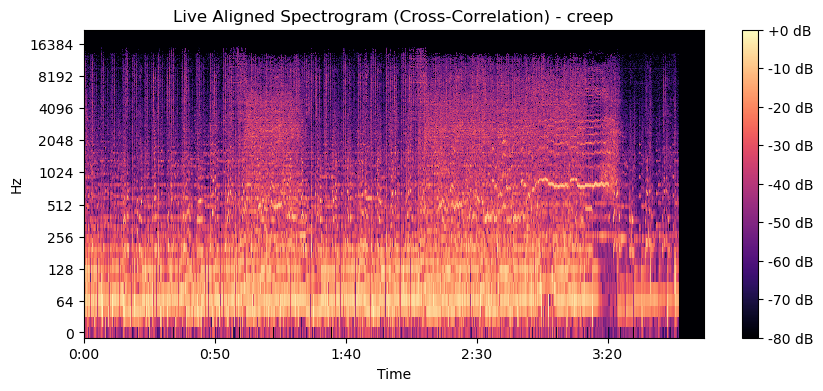

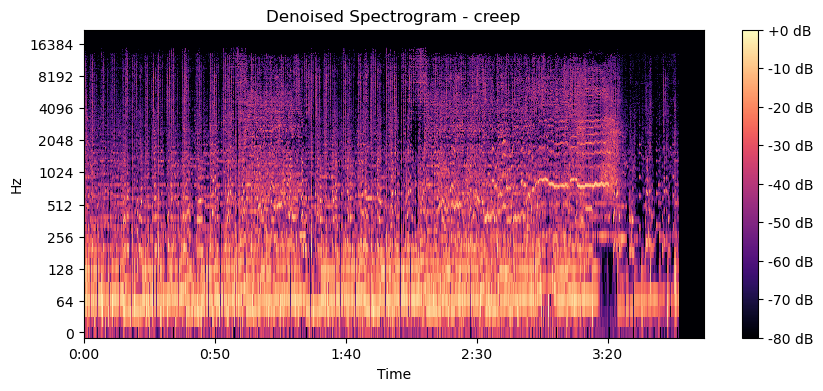

Finished processing 'creep'.


Processing 'bittersweet'...
  Found live file: 'song_bittersweet.mp3'
  Normalizing audio signals...
  Performing time alignment using cross-correlation...
  Comparing alignment accuracy...
    Cross-Correlation alignment error: 745.41
  Computing STFT using Cross-Correlation aligned audio...
  Applying spectral subtraction with adjusted scaling factor...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_bittersweet.wav'.
  Plotting the results...


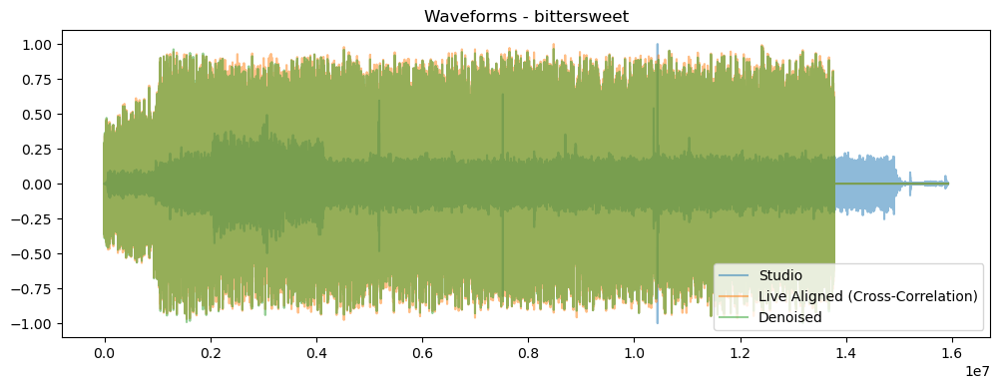

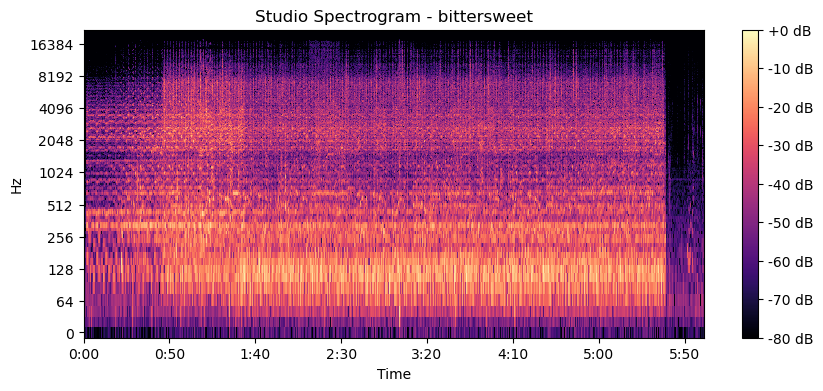

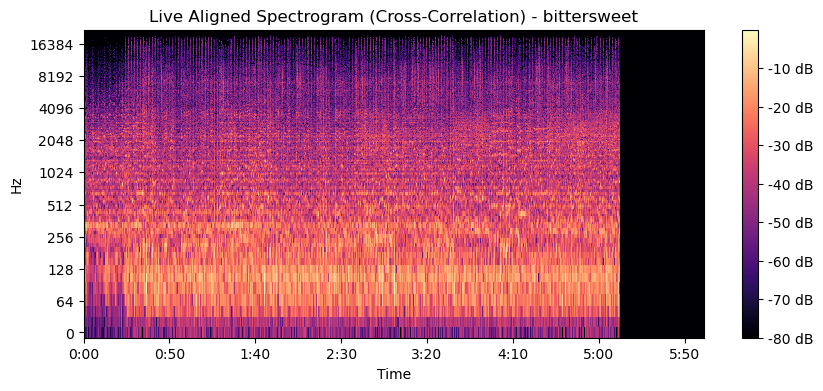

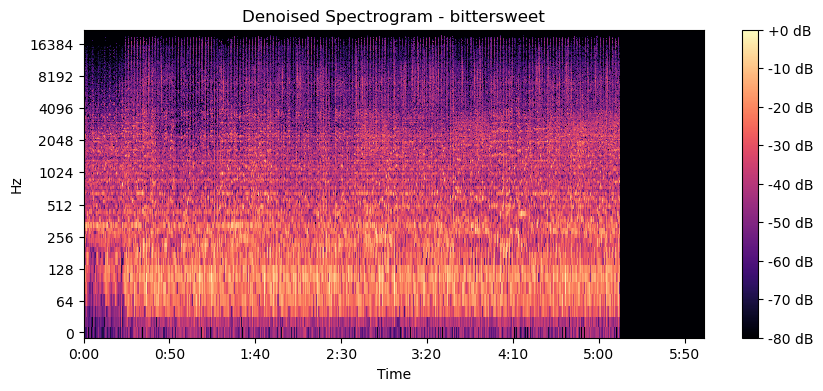

Finished processing 'bittersweet'.



In [3]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
from scipy.signal import correlate
import librosa.display
import pyloudnorm as pyln
import warnings
import os

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

def find_live_file(live_filename_base, possible_extensions=['mp3', 'm4a']):
    """
    Attempts to find the live audio file with one of the specified extensions.
    
    Parameters:
    - live_filename_base: str, base name of the live file without extension.
    - possible_extensions: list of str, possible extensions to check.
    
    Returns:
    - str or None: Path to the live file if found, else None.
    """
    for ext in possible_extensions:
        live_file = f"{live_filename_base}.{ext}"
        if os.path.exists(live_file):
            return live_file
    return None

def convert_and_denoise(song):
    live_base = song['live_base']
    studio_file = song['studio']
    song_name = os.path.splitext(os.path.basename(studio_file))[0]
    
    print(f"\nProcessing '{song_name}'...")
    
    # Find the live file with either .mp3 or .m4a extension
    live_file = find_live_file(live_base, ['mp3', 'm4a'])
    
    if live_file is None:
        print(f"  Error: No live file found for base name '{live_base}' with extensions .mp3 or .m4a.")
        print(f"  Skipping '{song_name}'.\n")
        return
    
    print(f"  Found live file: '{live_file}'")
    
    # Load live and studio recordings
    try:
        data_live, sr_live = librosa.load(live_file, sr=None, mono=True)
        data_studio, sr_studio = librosa.load(studio_file, sr=None, mono=True)
    except Exception as e:
        print(f"  Error loading files: {e}")
        print(f"  Skipping '{song_name}'.\n")
        return
    
    # Ensure sampling rates match
    if sr_live != sr_studio:
        print(f"  Resampling live recording from {sr_live} Hz to {sr_studio} Hz...")
        data_live = librosa.resample(data_live, sr_live, sr_studio)
        sr_live = sr_studio
    
    # Normalize the audio signals
    print("  Normalizing audio signals...")
    data_live = data_live / np.max(np.abs(data_live)) if np.max(np.abs(data_live)) != 0 else data_live
    data_studio = data_studio / np.max(np.abs(data_studio)) if np.max(np.abs(data_studio)) != 0 else data_studio
    
    # Truncate longer signal to match the shorter one
    min_length = min(len(data_live), len(data_studio))
    data_live = data_live[:min_length]
    data_studio = data_studio[:min_length]
    
    # Time alignment using cross-correlation
    print("  Performing time alignment using cross-correlation...")
    correlation = correlate(data_live, data_studio, mode='full')
    lag = np.argmax(correlation) - len(data_studio) + 1
    
    if lag > 0:
        data_live_aligned = data_live[lag:]
        if len(data_live_aligned) < len(data_studio):
            data_live_aligned = np.pad(data_live_aligned, (0, len(data_studio) - len(data_live_aligned)), 'constant')
    else:
        data_live_aligned = np.pad(data_live, (abs(lag), 0), 'constant')
    data_live_aligned = data_live_aligned[:len(data_studio)]
    
    # Compare Alignment Accuracy
    print("  Comparing alignment accuracy...")
    diff_cc = np.linalg.norm(data_live_aligned - data_studio)
    # Since we're only using cross-correlation, no DTW error
    print(f"    Cross-Correlation alignment error: {diff_cc:.2f}")
    
    # Proceed with denoising using cross-correlation alignment
    alignment_method = 'Cross-Correlation'
    
    # Compute STFT
    print(f"  Computing STFT using {alignment_method} aligned audio...")
    try:
        D_live = librosa.stft(data_live_aligned, n_fft=2048, hop_length=512)
        D_studio = librosa.stft(data_studio, n_fft=2048, hop_length=512)
    except Exception as e:
        print(f"  Error computing STFT: {e}")
        print(f"  Skipping '{song_name}'.\n")
        return
    
    # Compute magnitude and phase
    mag_live, phase_live = librosa.magphase(D_live)
    mag_studio, _ = librosa.magphase(D_studio)
    
    # Spectral subtraction with adjusted scaling factor
    print("  Applying spectral subtraction with adjusted scaling factor...")
    scaling_factor = 0.5  # Adjust between 0 and 1 to prevent over-subtraction
    mag_diff = mag_live - scaling_factor * mag_studio
    mag_diff = np.maximum(mag_diff, 0)
    
    # Reconstruct the denoised signal
    D_denoised = mag_diff * phase_live
    data_live_denoised = librosa.istft(D_denoised, hop_length=512)
    
    # Normalize the denoised audio
    max_val = np.max(np.abs(data_live_denoised))
    if max_val > 0:
        data_live_denoised = data_live_denoised / max_val
    else:
        print("  Warning: Denoised audio is silent.")
        data_live_denoised = np.zeros_like(data_live_denoised)
    
    # Check for non-finite values
    print("  Checking for non-finite values in denoised audio...")
    if not np.isfinite(data_live_denoised).all():
        print("  Non-finite values found in denoised audio. Replacing with zeros.")
        data_live_denoised = np.nan_to_num(data_live_denoised)
    
    # Save the denoised audio
    output_file = f"denoised_{song_name}.wav"
    try:
        sf.write(output_file, data_live_denoised, sr_studio)
        print(f"  Denoised audio saved to '{output_file}'.")
    except Exception as e:
        print(f"  Error saving denoised audio: {e}")
        print(f"  Skipping plotting for '{song_name}'.\n")
        return
    
    # Plotting the results
    print("  Plotting the results...")
    plt.figure(figsize=(12, 4))
    plt.title(f"Waveforms - {song_name}")
    plt.plot(data_studio, label='Studio', alpha=0.5)
    plt.plot(data_live_aligned, label=f'Live Aligned ({alignment_method})', alpha=0.5)
    plt.plot(data_live_denoised, label='Denoised', alpha=0.5)
    plt.legend()
    plt.show()
    
    # Plot spectrograms
    def plot_spectrogram(data, sr, title):
        if not np.isfinite(data).all():
            print(f"  Cannot plot spectrogram for '{title}' due to non-finite values.")
            return
        D = librosa.amplitude_to_db(np.abs(librosa.stft(data, n_fft=2048, hop_length=512)), ref=np.max)
        plt.figure(figsize=(10, 4))
        librosa.display.specshow(D, sr=sr, hop_length=512, x_axis='time', y_axis='log')
        plt.colorbar(format='%+2.0f dB')
        plt.title(title)
        plt.show()
    
    plot_spectrogram(data_studio, sr_studio, f'Studio Spectrogram - {song_name}')
    plot_spectrogram(data_live_aligned, sr_studio, f'Live Aligned Spectrogram ({alignment_method}) - {song_name}')
    plot_spectrogram(data_live_denoised, sr_studio, f'Denoised Spectrogram - {song_name}')
    
    print(f"Finished processing '{song_name}'.\n")

def main():
    """
    Main function to execute the conversion and denoising.
    Modify the 'songs' list with your actual file names.
    """
    # List of songs to process with base names for live files
    songs = [
        {'live_base': 'song_zombie', 'studio': 'zombie.wav'},
        {'live_base': 'song_creep', 'studio': 'creep.wav'},
        {'live_base': 'song_bittersweet', 'studio': 'bittersweet.wav'}
    ]
    
    # Process each song
    for song in songs:
        convert_and_denoise(song)

if __name__ == "__main__":
    main()



Processing 'zombie'...
  Found live file: 'song_zombie.mp3'
  Loaded Live Recording: 14026752 samples at 44100 Hz
  Loaded Studio Recording: 13768704 samples at 44100 Hz


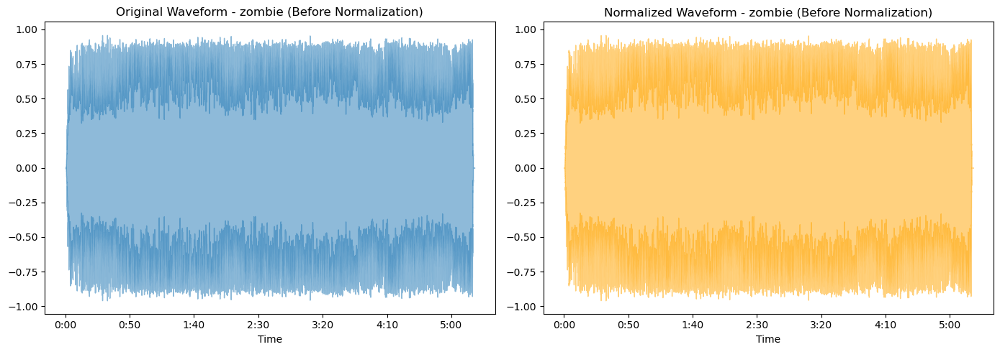

  Normalizing audio signals...


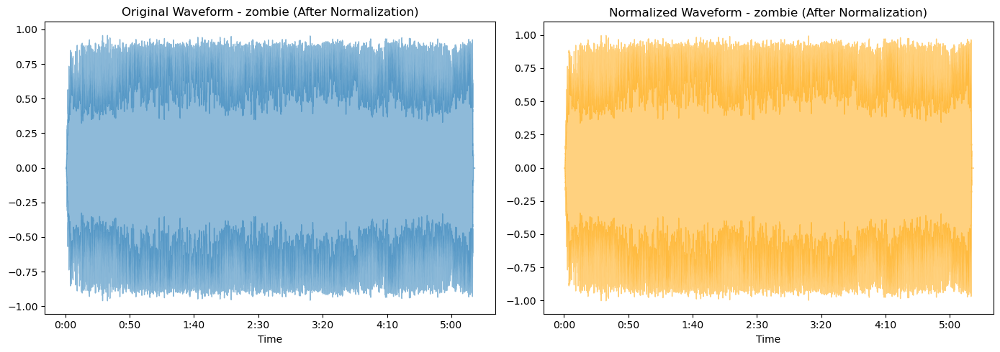

  Performing time alignment using cross-correlation...
    Optimal Lag: 25861 samples


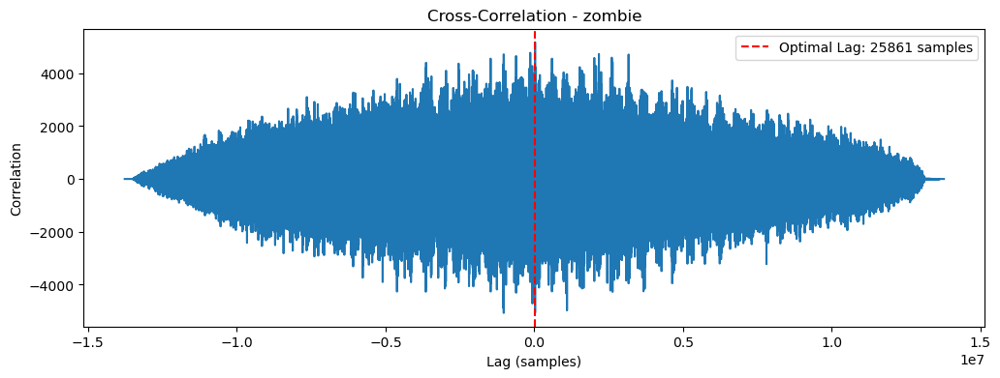

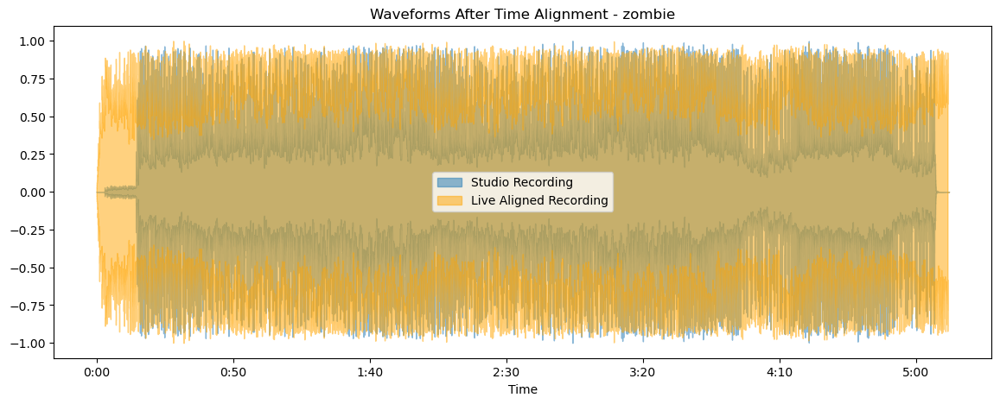

  Computing Short-Time Fourier Transform (STFT)...


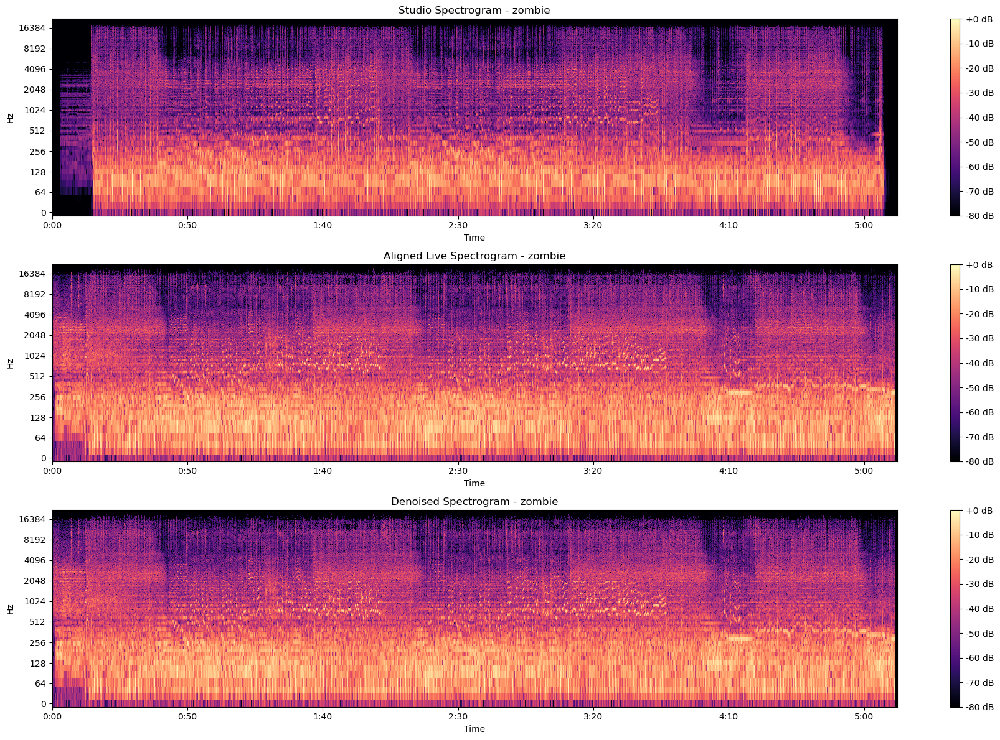

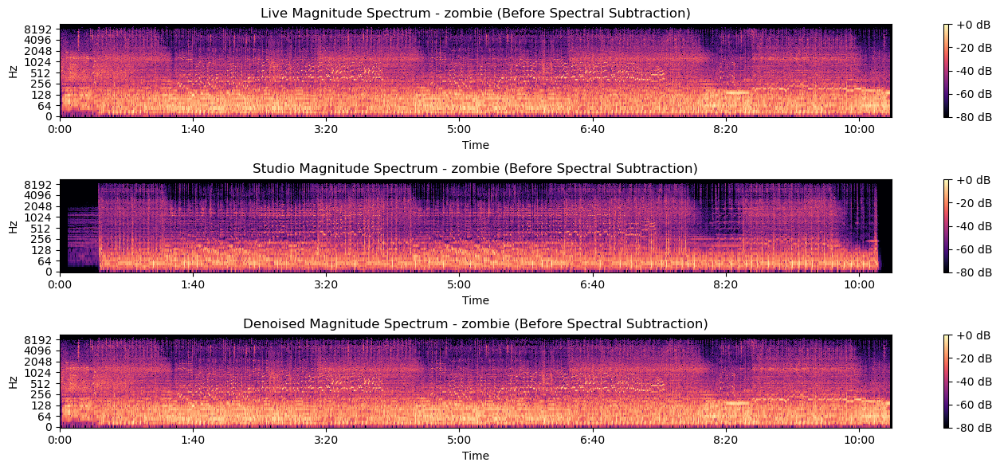

  Applying spectral subtraction with adjusted scaling factor...


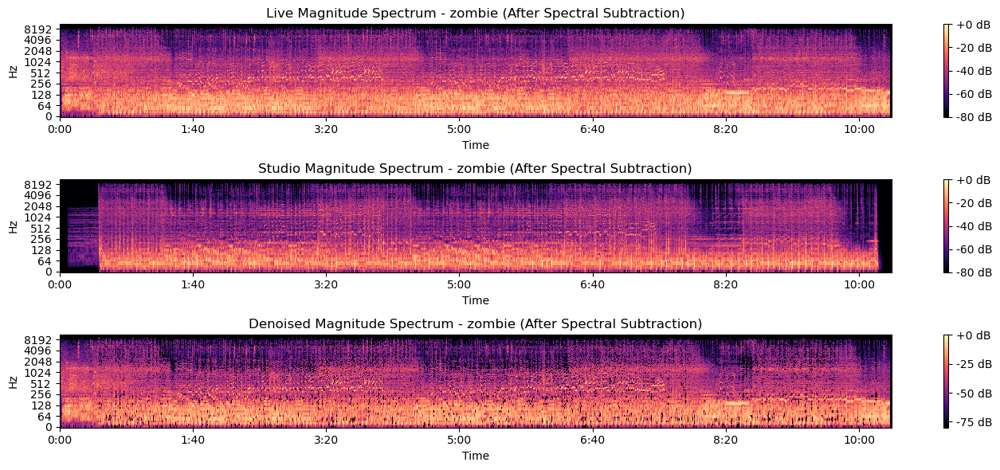

  Reconstructing denoised audio using Inverse STFT (ISTFT)...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_zombie.wav'.


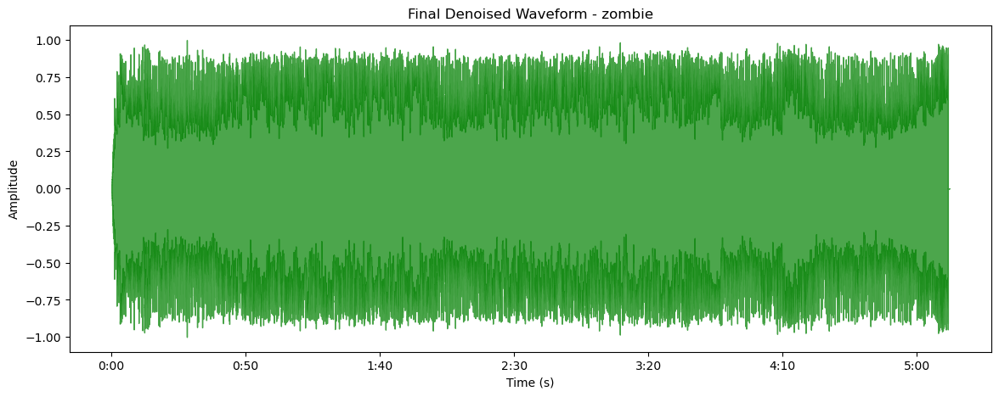

  Plotting final spectrogram...


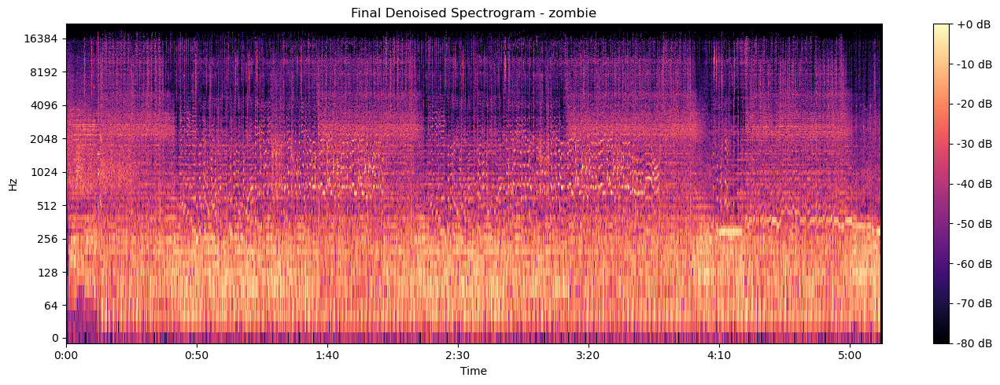

Finished processing 'zombie'.


Processing 'creep'...
  Found live file: 'song_creep.m4a'
  Loaded Live Recording: 11936704 samples at 44100 Hz
  Loaded Studio Recording: 10436608 samples at 44100 Hz


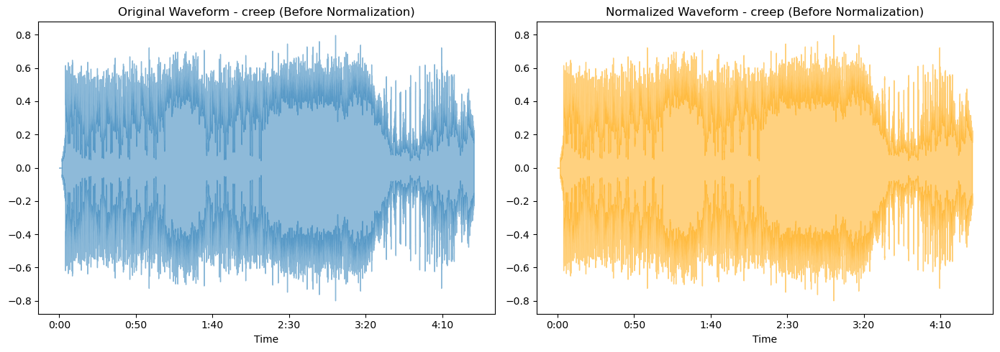

  Normalizing audio signals...


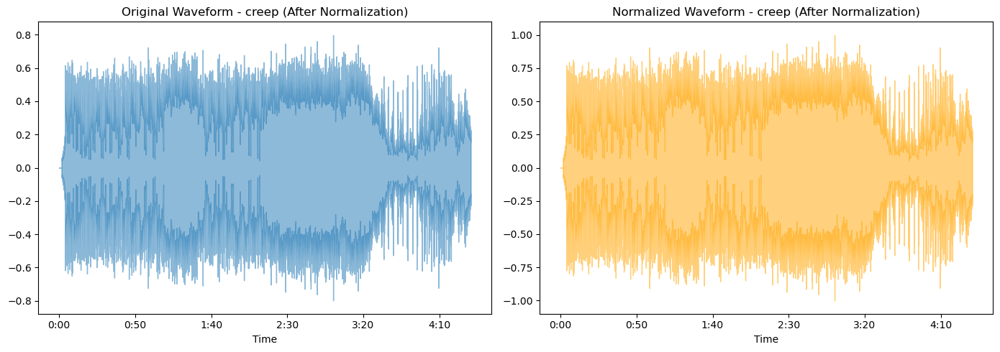

  Performing time alignment using cross-correlation...
    Optimal Lag: 418941 samples


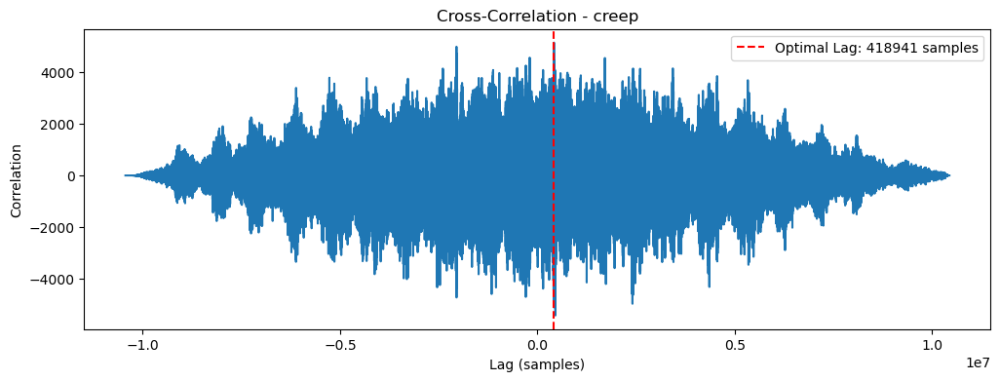

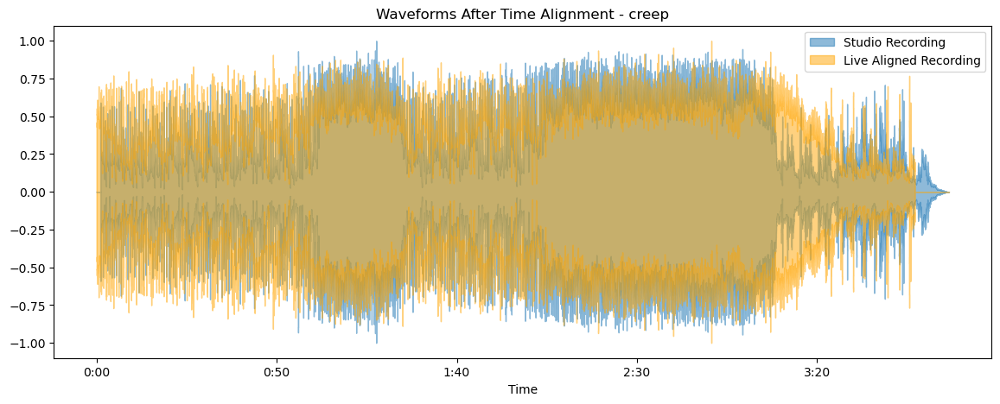

  Computing Short-Time Fourier Transform (STFT)...


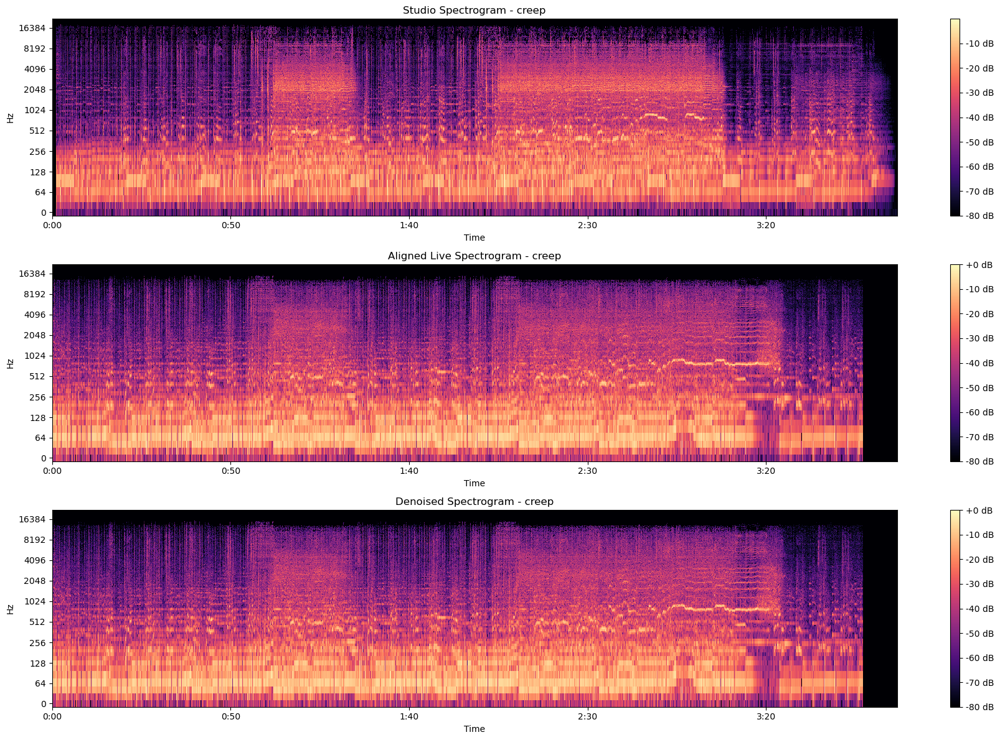

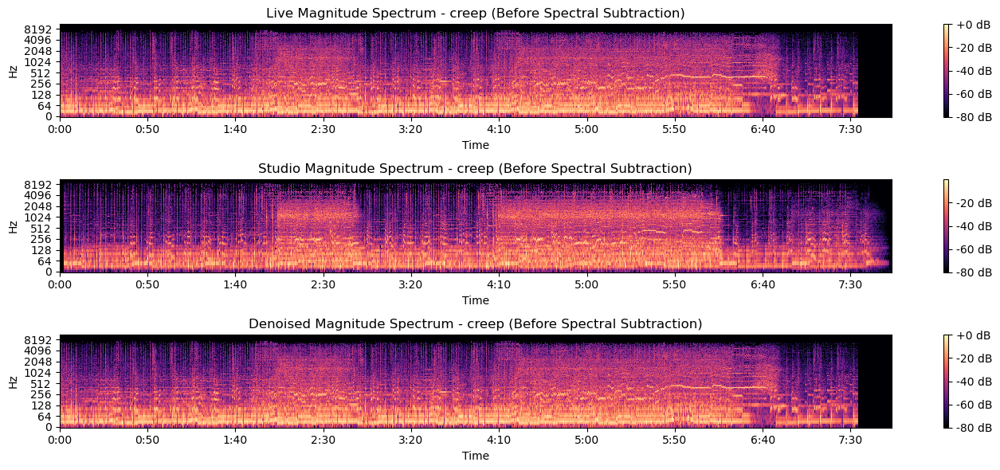

  Applying spectral subtraction with adjusted scaling factor...


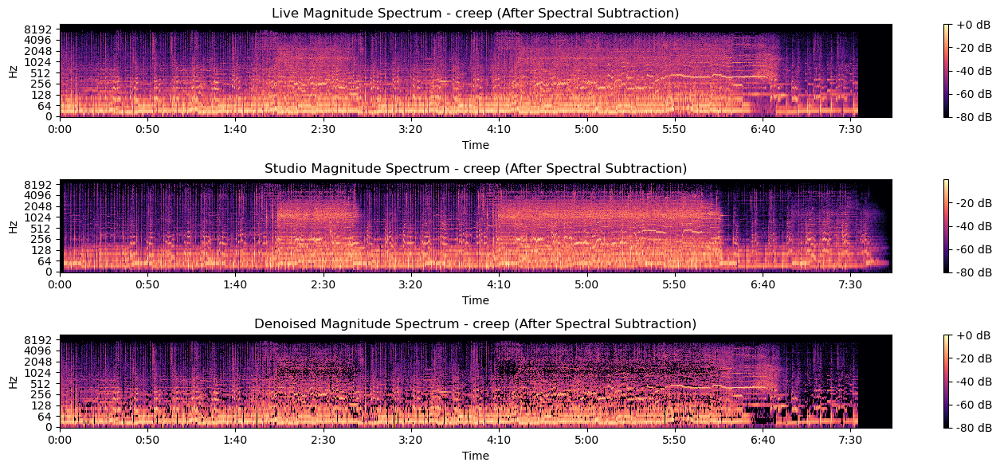

  Reconstructing denoised audio using Inverse STFT (ISTFT)...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_creep.wav'.


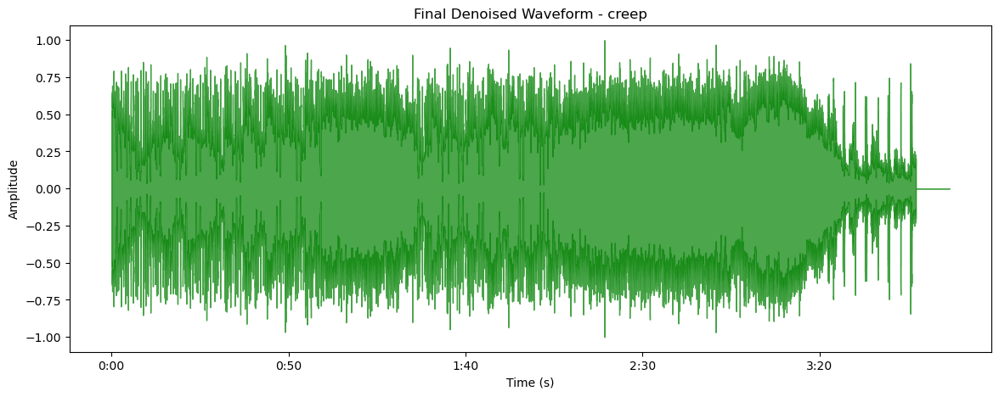

  Plotting final spectrogram...


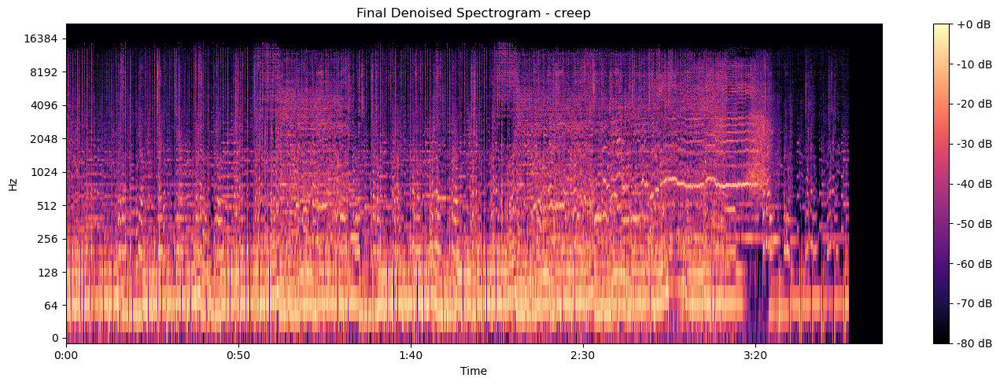

Finished processing 'creep'.


Processing 'bittersweet'...
  Found live file: 'song_bittersweet.mp3'
  Loaded Live Recording: 18260352 samples at 44100 Hz
  Loaded Studio Recording: 15926272 samples at 44100 Hz


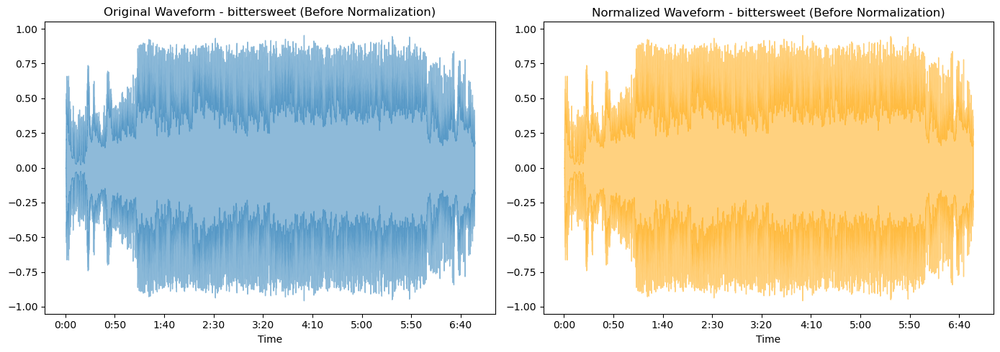

  Normalizing audio signals...


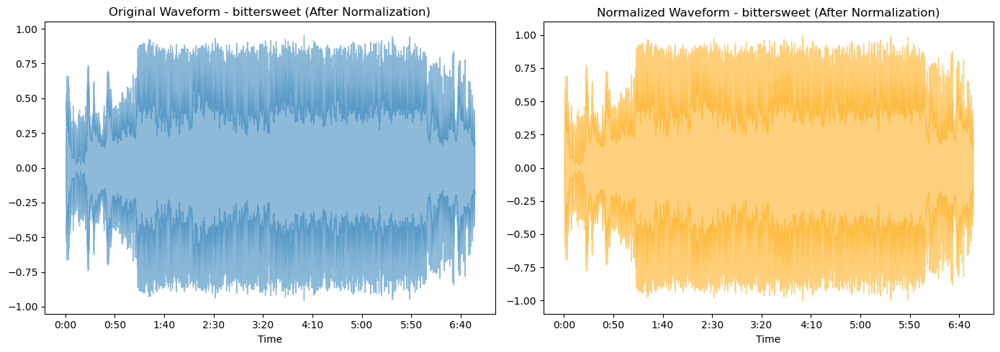

  Performing time alignment using cross-correlation...
    Optimal Lag: 2159953 samples


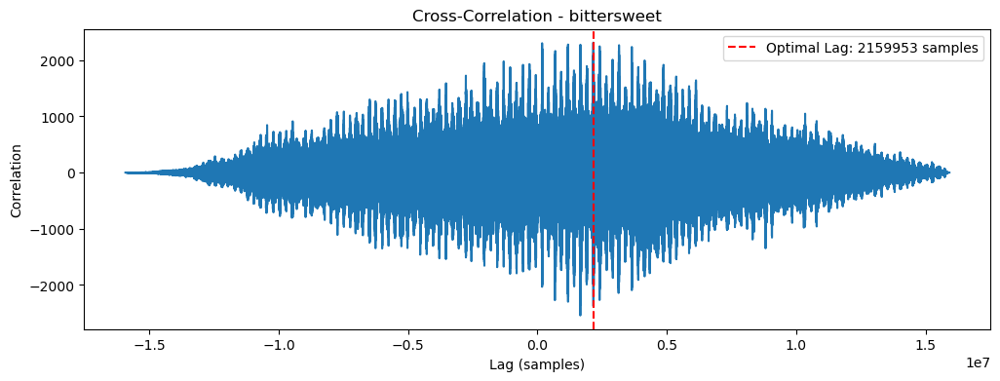

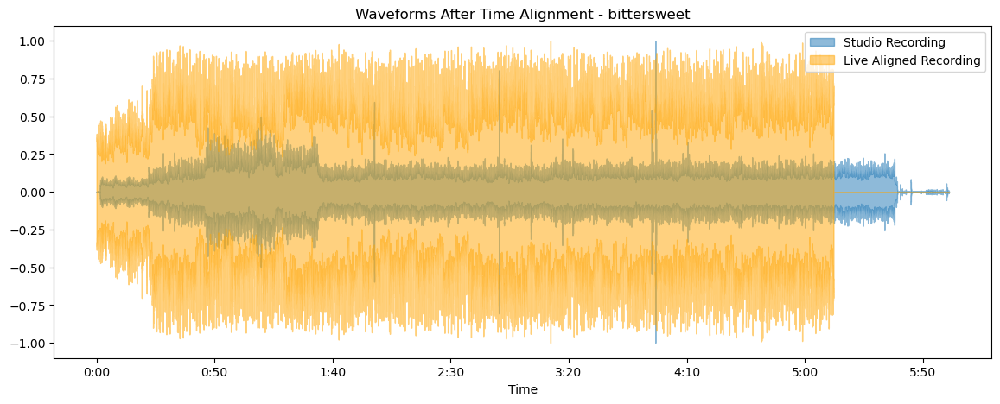

  Computing Short-Time Fourier Transform (STFT)...


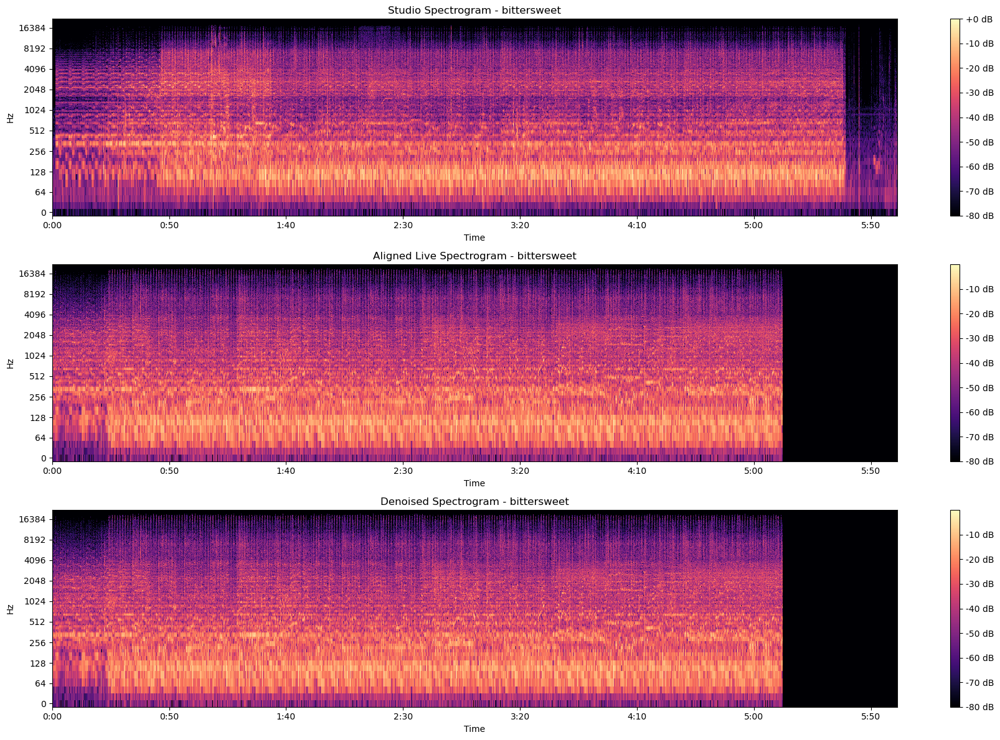

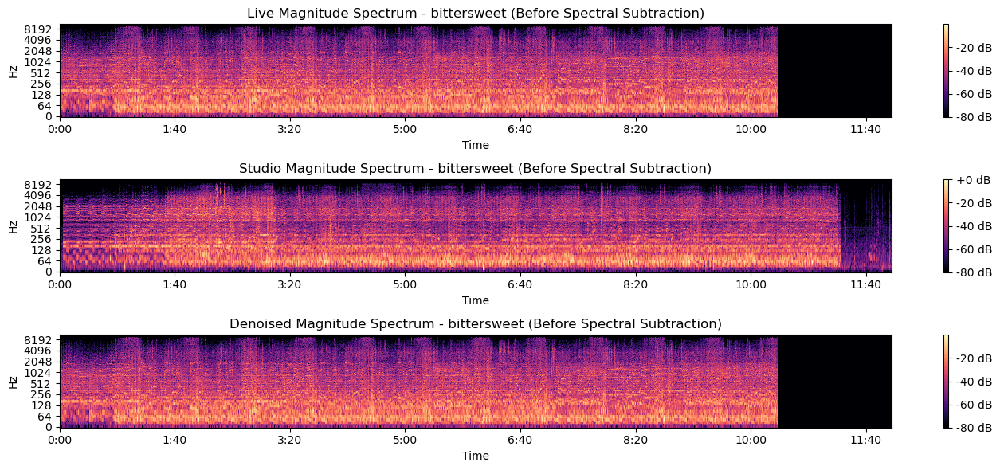

  Applying spectral subtraction with adjusted scaling factor...


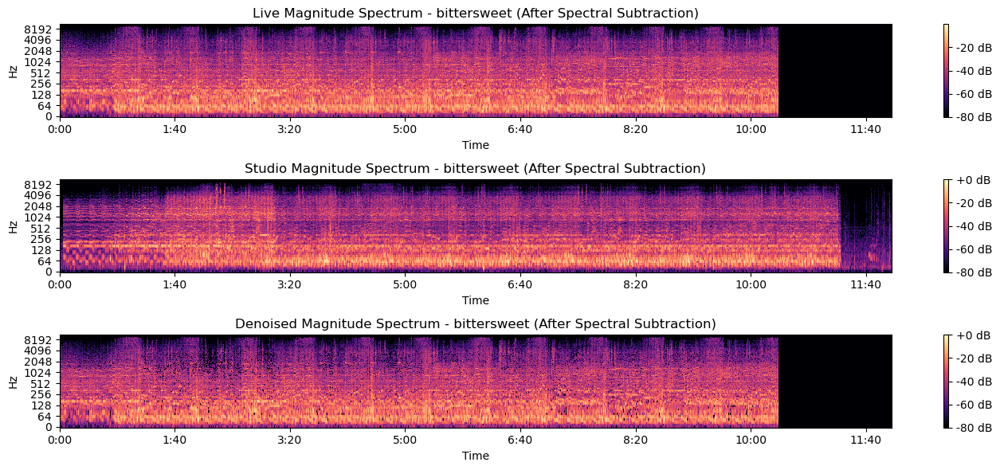

  Reconstructing denoised audio using Inverse STFT (ISTFT)...
  Checking for non-finite values in denoised audio...
  Denoised audio saved to 'denoised_bittersweet.wav'.


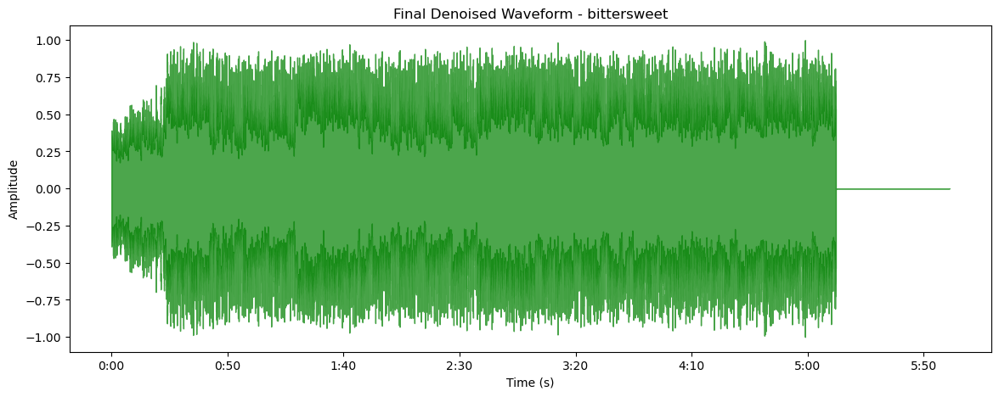

  Plotting final spectrogram...


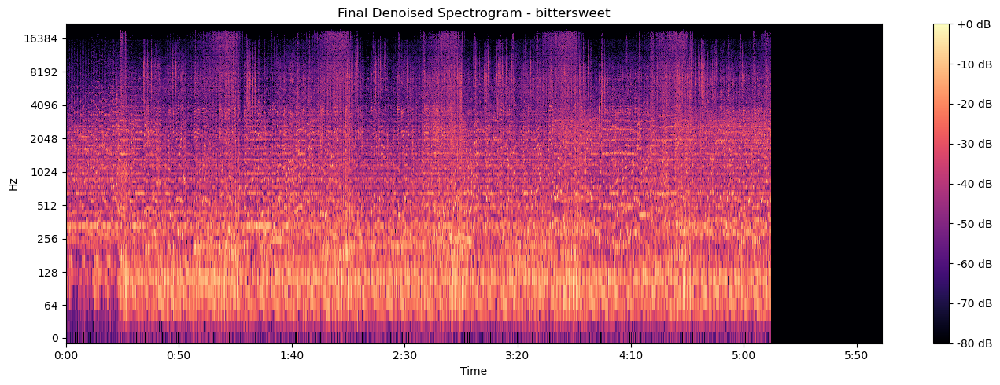

Finished processing 'bittersweet'.



In [4]:
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import soundfile as sf
from scipy.signal import correlate
import os
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

def find_live_file(live_filename_base, possible_extensions=['mp3', 'm4a']):
    """
    Attempts to find the live audio file with one of the specified extensions.
    
    Parameters:
    - live_filename_base: str, base name of the live file without extension.
    - possible_extensions: list of str, possible extensions to check.
    
    Returns:
    - str or None: Path to the live file if found, else None.
    """
    for ext in possible_extensions:
        live_file = f"{live_filename_base}.{ext}"
        if os.path.exists(live_file):
            return live_file
    return None

def plot_waveforms(original, normalized, sr, title):
    """
    Plots the original and normalized waveforms.
    
    Parameters:
    - original: np.ndarray, original audio signal.
    - normalized: np.ndarray, normalized audio signal.
    - sr: int, sampling rate.
    - title: str, title of the plot.
    """
    plt.figure(figsize=(14, 5))
    plt.subplot(1, 2, 1)
    librosa.display.waveshow(original, sr=sr, alpha=0.5)
    plt.title(f'Original Waveform - {title}')
    
    plt.subplot(1, 2, 2)
    librosa.display.waveshow(normalized, sr=sr, color='orange', alpha=0.5)
    plt.title(f'Normalized Waveform - {title}')
    
    plt.tight_layout()
    plt.show()

def plot_cross_correlation(correlation, lags, lag_max, title):
    """
    Plots the cross-correlation function and marks the optimal lag.
    
    Parameters:
    - correlation: np.ndarray, cross-correlation values.
    - lags: np.ndarray, corresponding lags.
    - lag_max: int, lag with maximum correlation.
    - title: str, title of the plot.
    """
    plt.figure(figsize=(12, 4))
    plt.plot(lags, correlation)
    plt.axvline(x=lag_max, color='r', linestyle='--', label=f'Optimal Lag: {lag_max} samples')
    plt.title(f'Cross-Correlation - {title}')
    plt.xlabel('Lag (samples)')
    plt.ylabel('Correlation')
    plt.legend()
    plt.show()

def plot_aligned_waveforms(studio, aligned_live, sr, title):
    """
    Plots the studio and aligned live waveforms.
    
    Parameters:
    - studio: np.ndarray, studio audio signal.
    - aligned_live: np.ndarray, time-aligned live audio signal.
    - sr: int, sampling rate.
    - title: str, title of the plot.
    """
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(studio, sr=sr, alpha=0.5, label='Studio Recording')
    librosa.display.waveshow(aligned_live, sr=sr, color='orange', alpha=0.5, label='Live Aligned Recording')
    plt.title(f'Waveforms After Time Alignment - {title}')
    plt.legend()
    plt.show()

def plot_spectrograms(studio, aligned_live, denoised, sr, title):
    """
    Plots the spectrograms of studio, aligned live, and denoised audio.
    
    Parameters:
    - studio: np.ndarray, studio audio signal.
    - aligned_live: np.ndarray, time-aligned live audio signal.
    - denoised: np.ndarray, denoised audio signal.
    - sr: int, sampling rate.
    - title: str, title of the plots.
    """
    plt.figure(figsize=(18, 12))
    
    # Studio Spectrogram
    plt.subplot(3, 1, 1)
    D_studio = librosa.amplitude_to_db(np.abs(librosa.stft(studio)), ref=np.max)
    librosa.display.specshow(D_studio, sr=sr, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Studio Spectrogram - {title}')
    
    # Aligned Live Spectrogram
    plt.subplot(3, 1, 2)
    D_live = librosa.amplitude_to_db(np.abs(librosa.stft(aligned_live)), ref=np.max)
    librosa.display.specshow(D_live, sr=sr, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Aligned Live Spectrogram - {title}')
    
    # Denoised Spectrogram
    plt.subplot(3, 1, 3)
    D_denoised = librosa.amplitude_to_db(np.abs(librosa.stft(denoised)), ref=np.max)
    librosa.display.specshow(D_denoised, sr=sr, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Denoised Spectrogram - {title}')
    
    plt.tight_layout()
    plt.show()

def plot_magnitude_spectra(mag_live, mag_studio, mag_diff, title):
    """
    Plots the magnitude spectra of live, studio, and their difference.
    
    Parameters:
    - mag_live: np.ndarray, magnitude spectrum of live audio.
    - mag_studio: np.ndarray, magnitude spectrum of studio audio.
    - mag_diff: np.ndarray, magnitude spectrum after spectral subtraction.
    - title: str, title of the plot.
    """
    plt.figure(figsize=(14, 6))
    
    # Live Magnitude Spectrum
    plt.subplot(3, 1, 1)
    librosa.display.specshow(librosa.amplitude_to_db(mag_live, ref=np.max),
                             sr=22050, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Live Magnitude Spectrum - {title}')
    
    # Studio Magnitude Spectrum
    plt.subplot(3, 1, 2)
    librosa.display.specshow(librosa.amplitude_to_db(mag_studio, ref=np.max),
                             sr=22050, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Studio Magnitude Spectrum - {title}')
    
    # Denoised Magnitude Spectrum
    plt.subplot(3, 1, 3)
    librosa.display.specshow(librosa.amplitude_to_db(mag_diff, ref=np.max),
                             sr=22050, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Denoised Magnitude Spectrum - {title}')
    
    plt.tight_layout()
    plt.show()

def plot_final_waveform(denoised, sr, title):
    """
    Plots the final denoised waveform.
    
    Parameters:
    - denoised: np.ndarray, denoised audio signal.
    - sr: int, sampling rate.
    - title: str, title of the plot.
    """
    plt.figure(figsize=(14, 5))
    librosa.display.waveshow(denoised, sr=sr, color='green', alpha=0.7)
    plt.title(f'Final Denoised Waveform - {title}')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.show()

def convert_and_denoise(song):
    """
    Processes a single song: normalization, alignment, STFT, spectral subtraction, ISTFT, and visualization.
    
    Parameters:
    - song: dict, contains 'live_base' and 'studio' keys.
    """
    live_base = song['live_base']
    studio_file = song['studio']
    song_name = os.path.splitext(os.path.basename(studio_file))[0]
    
    print(f"\nProcessing '{song_name}'...")
    
    # Find the live file with either .mp3 or .m4a extension
    live_file = find_live_file(live_base, ['mp3', 'm4a'])
    
    if live_file is None:
        print(f"  Error: No live file found for base name '{live_base}' with extensions .mp3 or .m4a.")
        print(f"  Skipping '{song_name}'.\n")
        return
    
    print(f"  Found live file: '{live_file}'")
    
    # Load live and studio recordings
    try:
        data_live, sr_live = librosa.load(live_file, sr=None, mono=True)
        data_studio, sr_studio = librosa.load(studio_file, sr=None, mono=True)
        print(f"  Loaded Live Recording: {len(data_live)} samples at {sr_live} Hz")
        print(f"  Loaded Studio Recording: {len(data_studio)} samples at {sr_studio} Hz")
    except Exception as e:
        print(f"  Error loading files: {e}")
        print(f"  Skipping '{song_name}'.\n")
        return
    
    # Ensure sampling rates match
    if sr_live != sr_studio:
        print(f"  Resampling live recording from {sr_live} Hz to {sr_studio} Hz...")
        data_live = librosa.resample(data_live, sr_live, sr_studio)
        sr_live = sr_studio
        print(f"  Resampled Live Recording: {len(data_live)} samples at {sr_live} Hz")
    
    # Plot waveforms before normalization
    plot_waveforms(original=data_live, normalized=data_live, sr=sr_live, title=song_name + " (Before Normalization)")
    
    # Normalize the audio signals
    print("  Normalizing audio signals...")
    max_live = np.max(np.abs(data_live))
    max_studio = np.max(np.abs(data_studio))
    
    data_live_normalized = data_live / max_live if max_live != 0 else data_live
    data_studio_normalized = data_studio / max_studio if max_studio != 0 else data_studio
    
    # Plot waveforms after normalization
    plot_waveforms(original=data_live, normalized=data_live_normalized, sr=sr_live, title=song_name + " (After Normalization)")
    
    # Truncate longer signal to match the shorter one
    min_length = min(len(data_live_normalized), len(data_studio_normalized))
    data_live_normalized = data_live_normalized[:min_length]
    data_studio_normalized = data_studio_normalized[:min_length]
    
    # Time alignment using cross-correlation
    print("  Performing time alignment using cross-correlation...")
    correlation = correlate(data_live_normalized, data_studio_normalized, mode='full')
    lags = np.arange(-len(data_studio_normalized) + 1, len(data_live_normalized))
    lag_max = lags[np.argmax(correlation)]
    print(f"    Optimal Lag: {lag_max} samples")
    
    # Plot cross-correlation
    plot_cross_correlation(correlation, lags, lag_max, title=song_name)
    
    # Align the live recording based on the optimal lag
    if lag_max > 0:
        data_live_aligned = data_live_normalized[lag_max:]
        if len(data_live_aligned) < len(data_studio_normalized):
            data_live_aligned = np.pad(data_live_aligned, (0, len(data_studio_normalized) - len(data_live_aligned)), 'constant')
    else:
        data_live_aligned = np.pad(data_live_normalized, (abs(lag_max), 0), 'constant')
    data_live_aligned = data_live_aligned[:len(data_studio_normalized)]
    
    # Plot aligned waveforms
    plot_aligned_waveforms(data_studio_normalized, data_live_aligned, sr_studio, title=song_name)
    
    # Compute STFT
    print("  Computing Short-Time Fourier Transform (STFT)...")
    D_live = librosa.stft(data_live_aligned, n_fft=2048, hop_length=512)
    D_studio = librosa.stft(data_studio_normalized, n_fft=2048, hop_length=512)
    
    # Plot spectrograms after alignment
    denoised_dummy = data_live_aligned  # Placeholder for denoised audio
    plot_spectrograms(data_studio_normalized, data_live_aligned, denoised_dummy, sr_studio, title=song_name)
    
    # Compute magnitude and phase
    mag_live, phase_live = librosa.magphase(D_live)
    mag_studio, _ = librosa.magphase(D_studio)
    
    # Plot magnitude spectra before subtraction
    plot_magnitude_spectra(mag_live, mag_studio, mag_live, title=song_name + " (Before Spectral Subtraction)")
    
    # Spectral subtraction with adjusted scaling factor
    print("  Applying spectral subtraction with adjusted scaling factor...")
    scaling_factor = 0.3  # Adjust between 0 and 1 to prevent over-subtraction
    mag_diff = mag_live - scaling_factor * mag_studio
    mag_diff = np.maximum(mag_diff, 0)
    
    # Plot magnitude spectra after subtraction
    plot_magnitude_spectra(mag_live, mag_studio, mag_diff, title=song_name + " (After Spectral Subtraction)")
    
    # Reconstruct the denoised signal
    print("  Reconstructing denoised audio using Inverse STFT (ISTFT)...")
    D_denoised = mag_diff * phase_live
    data_live_denoised = librosa.istft(D_denoised, hop_length=512)
    
    # Normalize the denoised audio
    max_denoised = np.max(np.abs(data_live_denoised))
    if max_denoised > 0:
        data_live_denoised = data_live_denoised / max_denoised
    else:
        print("  Warning: Denoised audio is silent.")
        data_live_denoised = np.zeros_like(data_live_denoised)
    
    # Check for non-finite values and replace with zeros if necessary
    print("  Checking for non-finite values in denoised audio...")
    if not np.isfinite(data_live_denoised).all():
        print("  Non-finite values found in denoised audio. Replacing with zeros.")
        data_live_denoised = np.nan_to_num(data_live_denoised)
    
    # Save the denoised audio
    output_file = f"denoised_{song_name}.wav"
    try:
        sf.write(output_file, data_live_denoised, sr_studio)
        print(f"  Denoised audio saved to '{output_file}'.")
    except Exception as e:
        print(f"  Error saving denoised audio: {e}")
        print(f"  Skipping final visualization for '{song_name}'.\n")
        return
    
    # Plot final denoised waveform
    plot_final_waveform(data_live_denoised, sr_studio, title=song_name)
    
    # Plot final spectrogram
    print("  Plotting final spectrogram...")
    plt.figure(figsize=(14, 5))
    D_final = librosa.amplitude_to_db(np.abs(librosa.stft(data_live_denoised)), ref=np.max)
    librosa.display.specshow(D_final, sr=sr_studio, hop_length=512, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'Final Denoised Spectrogram - {song_name}')
    plt.tight_layout()
    plt.show()
    
    print(f"Finished processing '{song_name}'.\n")

def main():
    """
    Main function to execute the conversion and denoising.
    Modify the 'songs' list with your actual file names.
    """
    # List of songs to process with base names for live files
    songs = [
        {'live_base': 'song_zombie', 'studio': 'zombie.wav'},
        {'live_base': 'song_creep', 'studio': 'creep.wav'},
        {'live_base': 'song_bittersweet', 'studio': 'bittersweet.wav'}
    ]
    
    # Process each song
    for song in songs:
        convert_and_denoise(song)

if __name__ == "__main__":
    main()
